# Apresentação

Disciplina: RNA e Deep Learning

Aluno: Cláusio Tiberio Teixeira Barbosa

### Verificado se está conectado a GPU

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sat Oct 28 12:11:59 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Preparação do dataset

A estrutura necessária é a seguinte

* /dataset
  * /train
  * /val

In [2]:
#mais simples de usar
usar_gdrive = False
usar_wandb = True

### Copiando o conjunto de imagens de treinamento

In [3]:
if(usar_gdrive):
  from google.colab import drive
  drive.mount('/content/gdrive')
  !cp /content/gdrive/MyDrive/EstudoYolo/yolov8.zip ./
  !mkdir pos-cesar-object-detection
  !mkdir pos-cesar-object-detection/dataset
  !unzip yolov8.zip -d pos-cesar-object-detection/dataset/
else:
  ! git clone https://github.com/claus235/pos-cesar-object-detection/


Cloning into 'pos-cesar-object-detection'...
remote: Enumerating objects: 827, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 827 (delta 11), reused 2 (delta 2), pack-reused 813
Receiving objects: 100% (827/827), 43.99 MiB | 42.69 MiB/s, done.
Resolving deltas: 100% (47/47), done.


## Usando Weights & Biases

In [4]:
if(usar_wandb):
  !pip install wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 25.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 22.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 241.0/241.0 kB 29.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.4 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8791 sha256=e3c2fee9b46e254c416ff6bece8042d7b3c9f89733bcde0e8de1127e2751f2c7
  Stored in directory: /root/.cache/pip/wheels/e7/f3/22/152153d6eb222ee7a56ff8617d80ee5207207a8c00a7aab794
Successfully built pathtools


In [5]:
if(usar_wandb):
  !wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


## Instalação das ferramentas do YOLOv8

In [6]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.8/644.8 kB 6.5 MB/s eta 0:00:00


In [7]:
from ultralytics import YOLO
import os
import cv2
import matplotlib.pyplot as plt

## Treinamento do modelo

In [8]:
diretorio_raiz = '/content/pos-cesar-object-detection/dataset'
arquivo_config = os.path.join(diretorio_raiz, 'data.yaml')

In [9]:
arquivo_config

'/content/pos-cesar-object-detection/dataset/data.yaml'

> **Parâmetros da função de treinamento:**

* task: o que queremos com o treinamento. Como estamos trabalhando com detecção de objetos, deixe o valor = detect. Outras opções aceitas: segment, e classify. É opcional passarmos se queremos detecção, pois por padrão ele já considera como sendo detecção a não ser que especifique outra forma.
* mode: pode ser train, val, ou predict. Como estamos fazendo pela forma usando python e queremos o treinamento vamos usar a função train(), portanto esse parâmetro se torna desnecessário .
* **model**: o modelo pré-treinado que queremos usar como "partida". Pode ser o YOLOv8 Nano (YOLOv8n), YOLOv8 Small (YOLOv8s), etc.
* **imgsz**: O tamanho da imagem, que a rede realiza o processamento (obs: você não precisa redimensionar a imagem para esse tamanho antes, o algoritmo cuida dessa parte antes de passar a imagem de entrada para a rede). A resolução padrão é 640x640 pixels, portanto o valor padrão é 640. Quando maior o tamanho mais precisa é a detecção, principalmente para objetos com detalhes pequenos, porém é mais demorado o treinamento e detecção.  
* **data**: caminho para o arquivo YAML. Esse é o arquivo que criamos acima, que contém o caminho para o conjunto de treinamento e validaçao, além disso deve conter os nomes das classes que queremos treinar.
* **epochs**: Numero de epocas que desejamos treinar.
* **batch**: O tamanho do batch (lote) para o carregador de dados. Você pode aumentá-lo ou diminuí-lo de acordo com a disponibilidade de memória de sua GPU, por exemplo caso venha a encontrar problema de memória. O valor padrão é 16.
* **name**: Nome do diretório de resultados para o runs/detect. (opcional)

Em nossos testes vamos escolher o Nano, ou até mesmo o Small, pois queremos que seja um treinamento relativamente mais rápido

In [10]:
model = YOLO('yolov8s.yaml')


                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

In [11]:
resultados = model.train(data=arquivo_config, epochs=1000, imgsz=640, name='yolov8s_modelo')

Ultralytics YOLOv8.0.202 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/pos-cesar-object-detection/dataset/data.yaml, epochs=1000, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8s_modelo, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=Tru

Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
100%|██████████| 6.23M/6.23M [00:00<00:00, 73.2MB/s]
AMP: checks passed ✅
train: Scanning /content/pos-cesar-object-detection/dataset/train/labels... 285 images, 135 backgrounds, 0 corrupt: 100%|██████████| 285/285 [00:00<00:00, 2229.51it/s]
train: New cache created: /content/pos-cesar-object-detection/dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
val: Scanning /content/pos-cesar-object-detection/dataset/valid/labels... 37 images, 15 backgrounds, 0 corrupt: 100%|██████████| 37/37 [00:00<00:00, 1511.02it/s]
val: New cache created: /content/pos-cesar-object-detection/dataset/valid/labels.cache
Plotting labels to runs/detect/yolov8s_modelo/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determi

lr/pg0,▁███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▁███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▁███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▁▁▁▂▂▃▄▃▄▃▂▅▅▅▄▄▆▄▇▆▅▆▆▆▆▆▇▇▇▆▇▇█▇▇▇█▇▇
metrics/mAP50-95(B),▁▁▁▁▁▂▃▃▂▄▂▂▄▄▄▃▄▅▅▆▆▆▆▆▆▅▆▇▅█▆▅▆█▇▇▇█▇▆
metrics/precision(B),▁▁▁▁▅▇▇▃▂▇▇█▅▄▄▃▄▄▄▄▃▃▄▄█▄▄▅▄▅▄▄▄▆▆▄▄▆▇▄
metrics/recall(B),▂▅▂█▁▁▃▂▃▂▁▁▅▅▅▃▃▆▄▇▆▆▅▇▅▆▇█▇▇▆▇▆▇▇▇▇▇▇█
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,██▇▆▆▆▆▅▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁


In [12]:
dir_resultado = '/content/runs/detect/yolov8s_modelo'

### Avaliação (Verificando o mAP do modelo)

In [13]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [14]:
!yolo task=detect mode=val model={dir_resultado}/weights/best.pt name=yolov8s_modelo_eval data=/content/pos-cesar-object-detection/dataset/data.yaml

Ultralytics YOLOv8.0.202 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/pos-cesar-object-detection/dataset/valid/labels.cache... 37 images, 15 backgrounds, 0 corrupt: 100% 37/37 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 3/3 [00:02<00:00,  1.40it/s]
                   all         37         36       0.48        0.5      0.466       0.22
                Bueiro         37         18      0.779      0.778      0.824      0.418
                Buraco         37         18      0.181      0.222      0.108     0.0207
Speed: 5.6ms preprocess, 29.1ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to runs/detect/yolov8s_modelo_eval
💡 Learn more at https://docs.ultralytics.com/modes/val


### Exibindo os gráficos

In [15]:
def mostrar(img):
  fig = plt.gcf()
  fig.set_size_inches(16, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  plt.show()

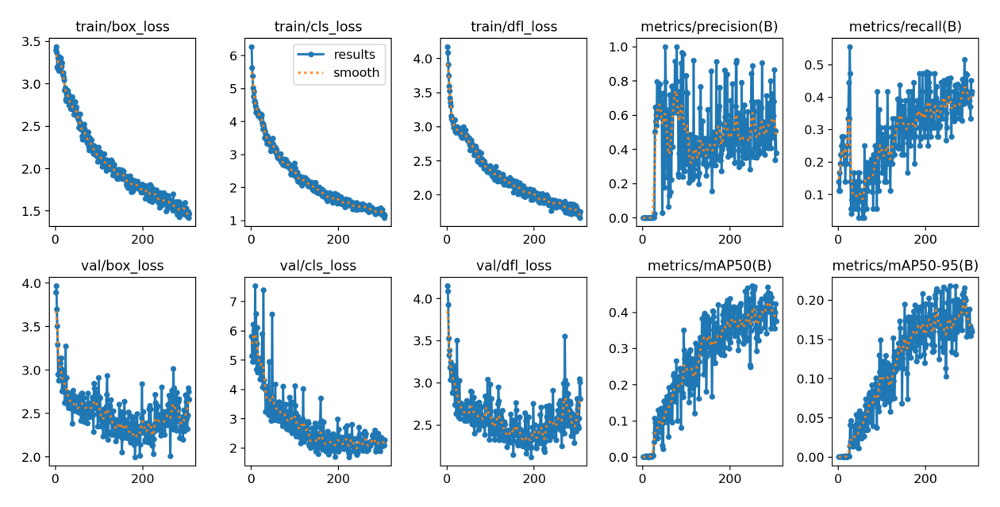

In [16]:
resultados_grafico = cv2.imread(os.path.join(dir_resultado, 'results.png'))
mostrar(resultados_grafico)

In [17]:
dir_resultado_val = 'runs/detect/yolov8s_modelo_eval'

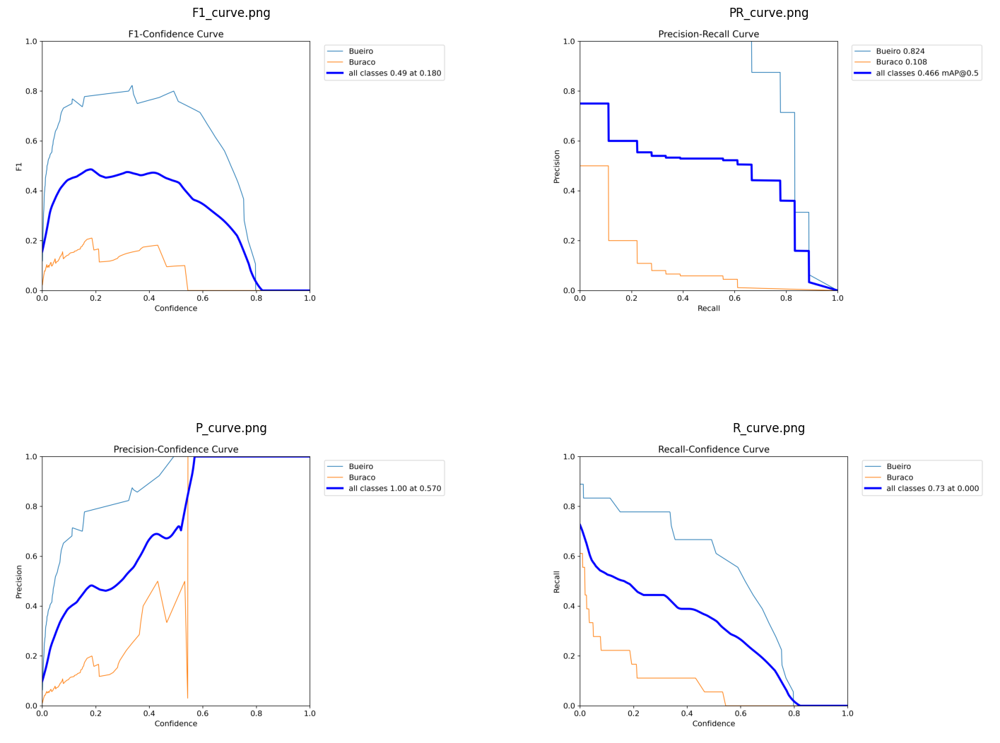

In [18]:
imgs = ['F1_curve.png', 'PR_curve.png', 'P_curve.png', 'R_curve.png']
plt.figure(figsize=(18,14))
for i, img in enumerate(imgs):
  #print(i, img)
  grafico = cv2.imread(os.path.join(dir_resultado_val, img))
  #print(grafico)
  grafico = cv2.cvtColor(grafico, cv2.COLOR_BGR2RGB)
  plt.subplot(2, 2, i + 1)
  plt.title(imgs[i])
  plt.imshow(grafico)
  plt.axis('off')
plt.show()

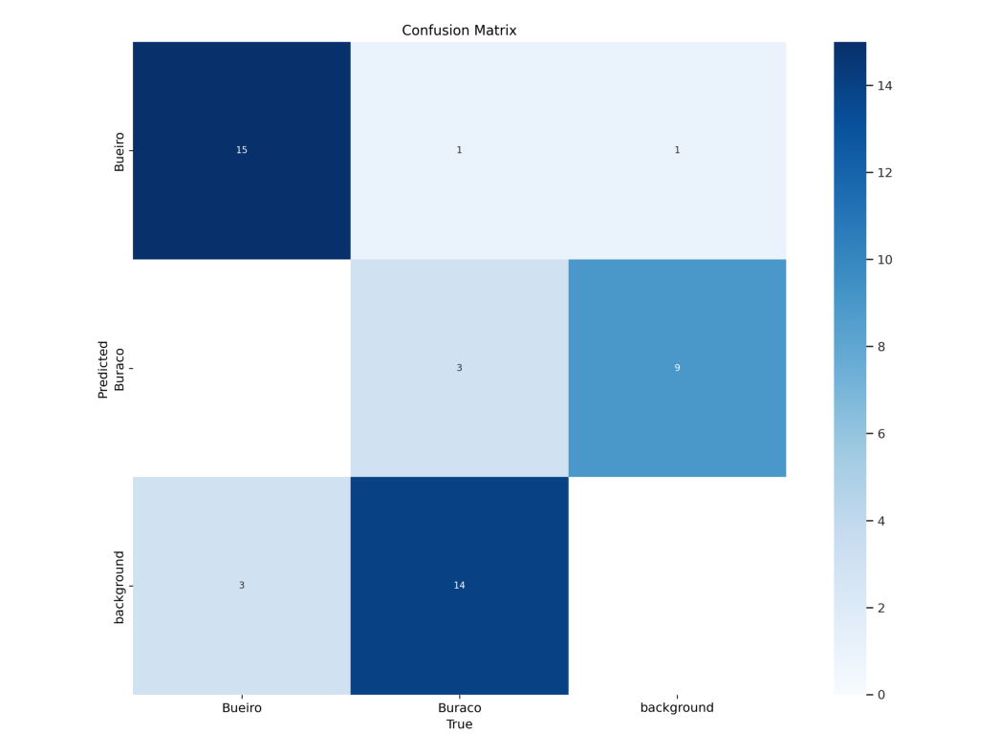

In [19]:
matriz_confusao = cv2.imread(os.path.join(dir_resultado_val, 'confusion_matrix.png'))
mostrar(matriz_confusao)

## Testando o modelo treinado


In [20]:
!yolo task=detect mode=predict model={dir_resultado}/weights/best.pt source='/content/pos-cesar-object-detection/dataset/test/images' save=true conf=0.05

Ultralytics YOLOv8.0.202 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

image 1/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (27).png: 352x640 (no detections), 68.8ms
image 2/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (28).png: 352x640 1 Bueiro, 24.3ms
image 3/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (29).png: 352x640 1 Bueiro, 10.9ms
image 4/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (34).png: 352x640 1 Bueiro, 1 Buraco, 10.7ms
image 5/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (35).png: 352x640 3 Bueiros, 2 Buracos, 10.7ms
image 6/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (39).png: 352x640 (no detections), 11.3ms
image 7/19 /content/pos-cesar-object-detection/dataset/test/images/streetviewImg (56).png: 352x6

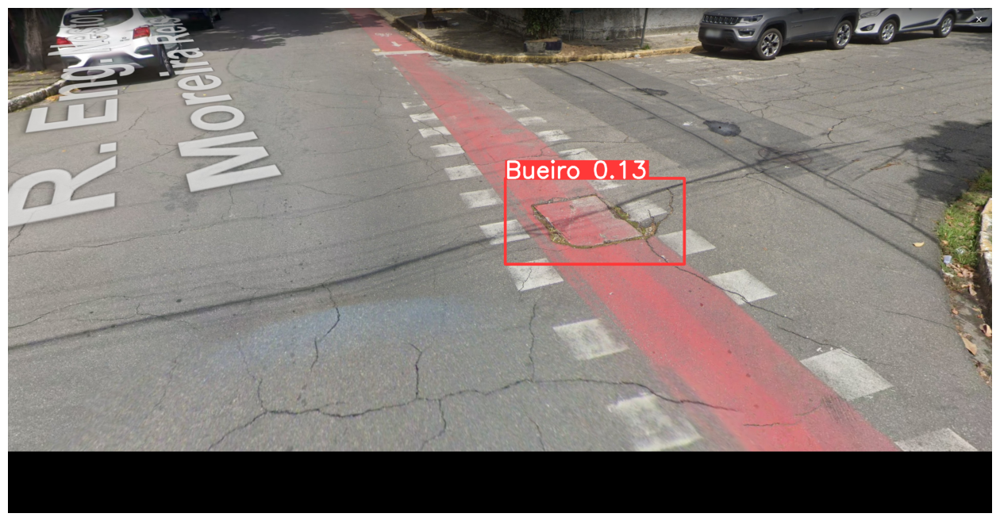

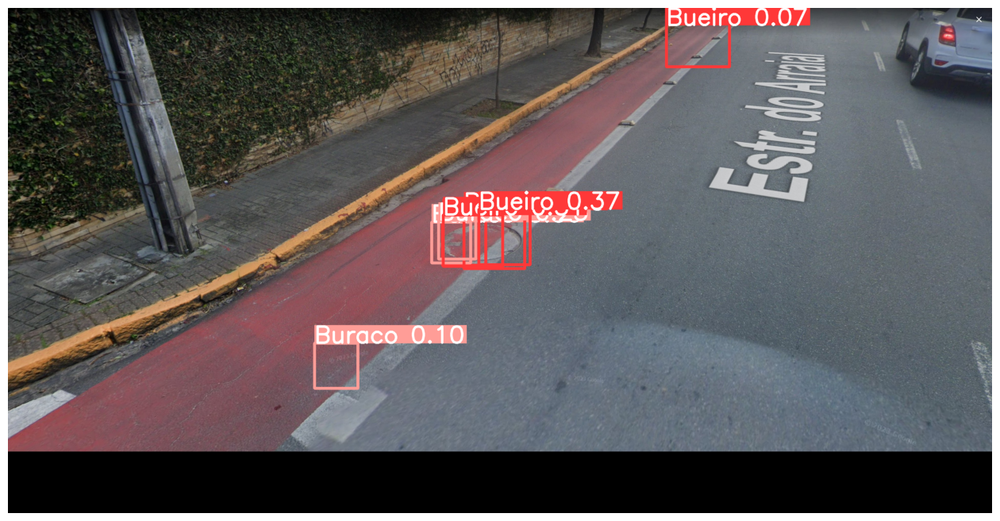

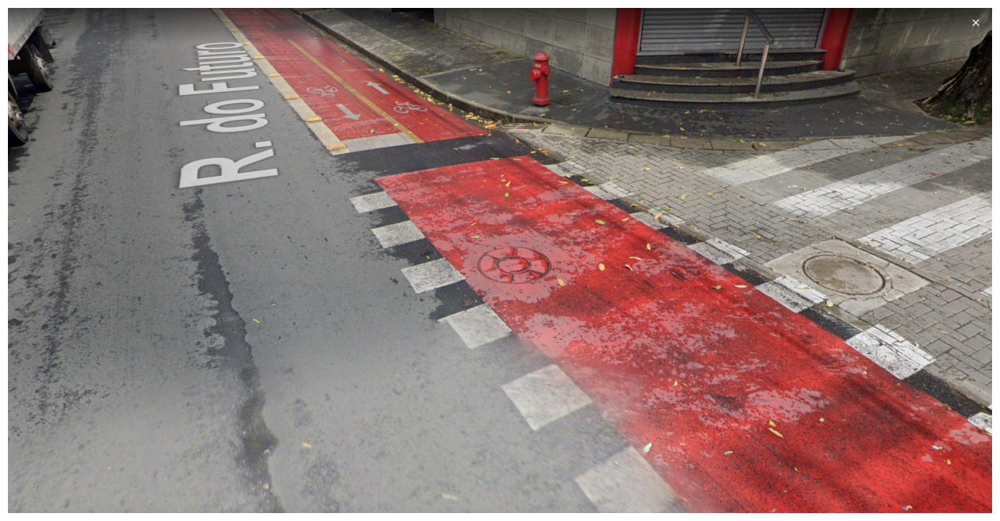

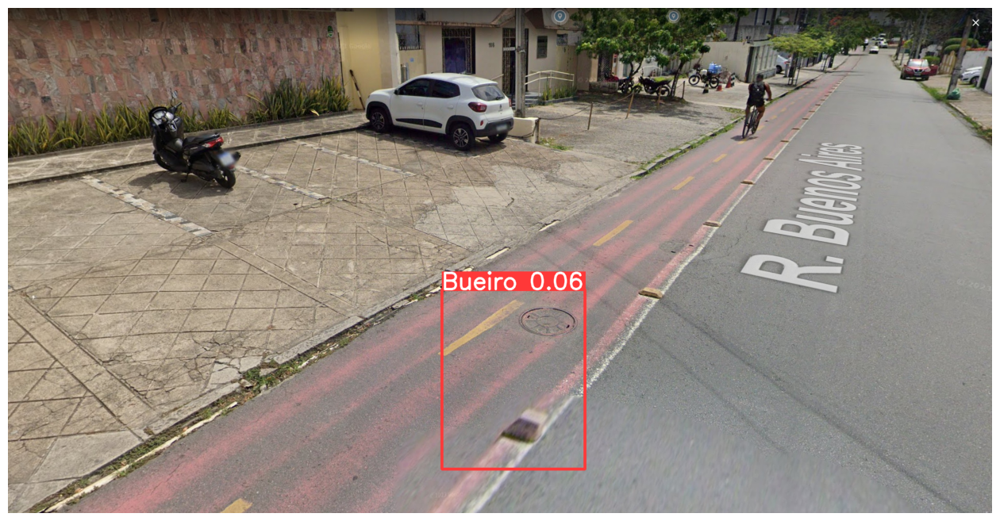

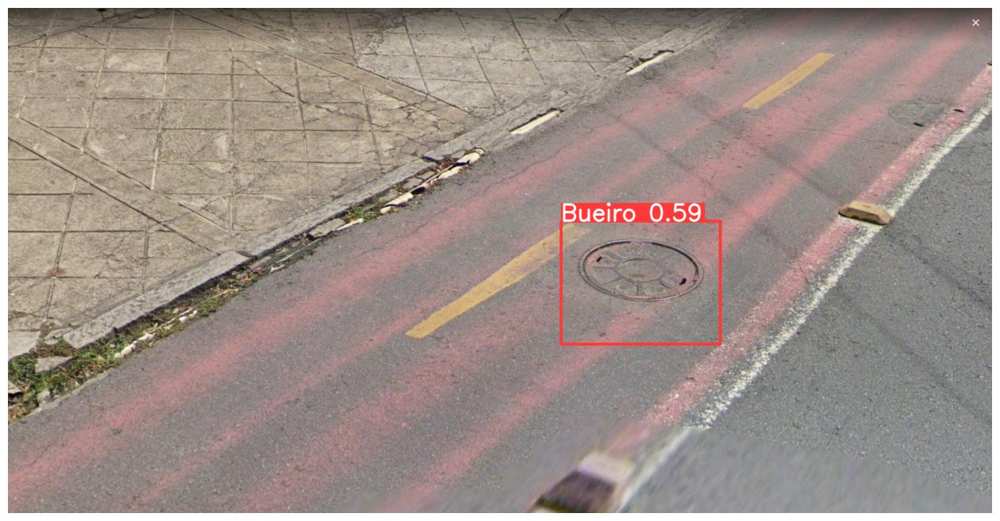

...

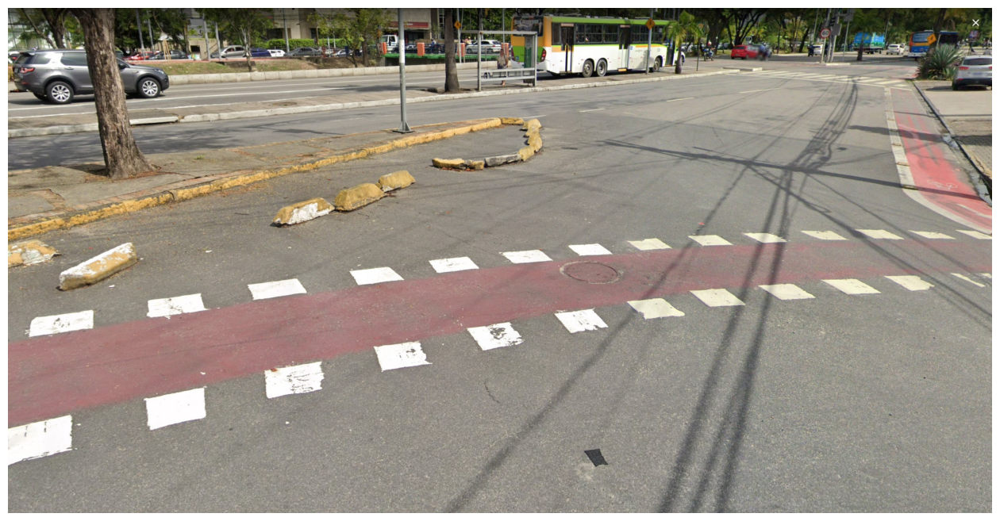

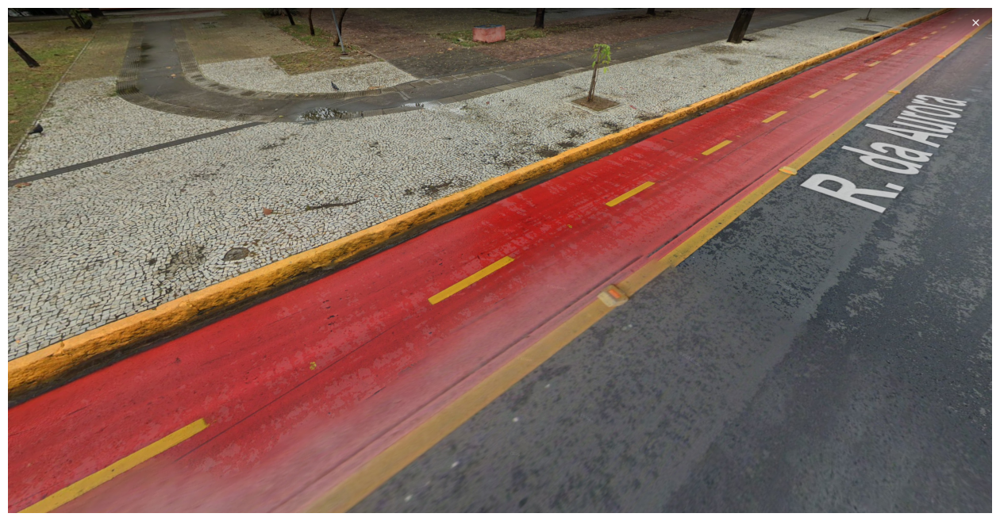

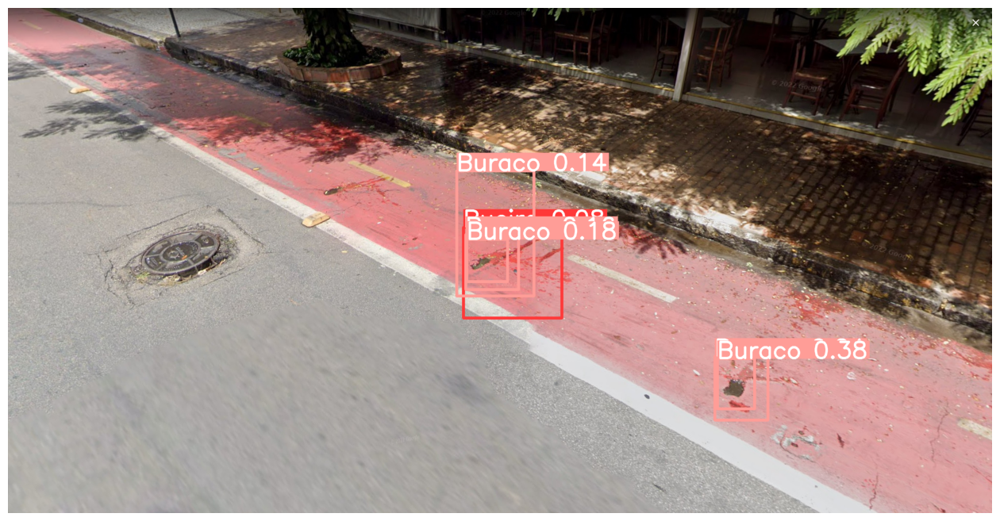

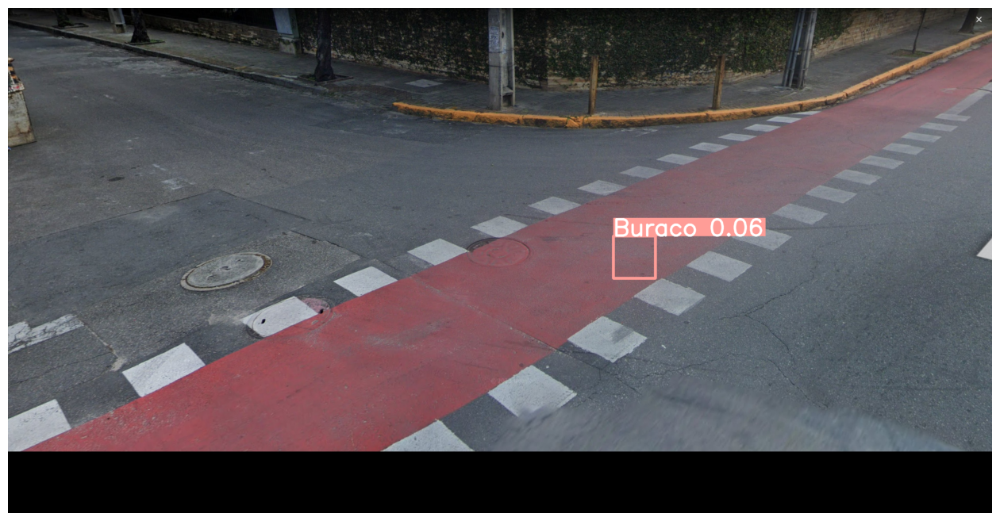

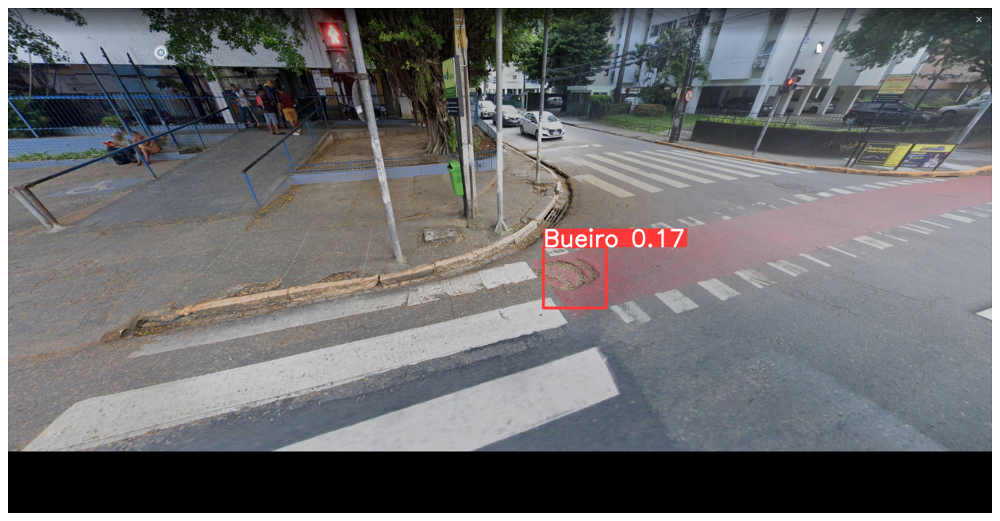

In [21]:
dir_predicoes = 'runs/detect/predict/'
caminhos = [os.path.join(dir_predicoes, f) for f in os.listdir(dir_predicoes)]
#print(caminhos)
for caminho_imagem in caminhos:
  imagem = cv2.imread(caminho_imagem)
  mostrar(imagem)